In [2]:
#空间杜宾模型
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from libpysal.weights import KNN, DistanceBand
from spreg import GM_Lag

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建空间权重矩阵（基于K最近邻方法，尝试不同的k值）
knn = KNN.from_array(coords, k=8)  # 尝试将k值增加到8

# 如果KNN仍然不收敛，可以尝试使用DistanceBand创建基于距离的空间权重矩阵
# dist_band = DistanceBand.from_array(coords, threshold=1000)  # 根据实际情况调整阈值

# 应用空间杜宾模型（GM Lag Model）
try:
    model = GM_Lag(y.flatten(), X_scaled, w=knn, name_y=y_column, name_x=X_columns, spat_diag=True)
    print(model.summary)
except Exception as e:
    print(f"An error occurred: {e}")
    # 如果KNN仍不收敛，可以尝试使用DistanceBand
    dist_band = DistanceBand.from_array(coords, threshold=1000)  # 根据实际情况调整阈值
    try:
        model = GM_Lag(y.flatten(), X_scaled, w=dist_band, name_y=y_column, name_x=X_columns, spat_diag=True)
        print(model.summary)
    except Exception as e:
        print(f"An error occurred with DistanceBand: {e}")

An error occurred: power expansion will not converge, check model specification and that weight are less than 1
REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: SPATIAL TWO STAGE LEAST SQUARES
--------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          39
S.D. dependent var  :      2.8771                Degrees of Freedom    :         898
Pseudo R-squared    :      0.6412
Spatial Pseudo R-squared:  0.6417

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        10.00000    
       build_buguize         0.02608    
          avg_heig

C:\ProgramData\anaconda3\Lib\site-packages\spreg\diagnostics.py:367: RuntimeWarning: invalid value encountered in sqrt
  se_result = np.sqrt(variance)
C:\ProgramData\anaconda3\Lib\site-packages\spreg\diagnostics.py:183: RuntimeWarning: invalid value encountered in sqrt
  ) / np.sqrt(variance)


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 示例数据：假设这是从模型中提取的系数信息
# 请注意，你需要替换这些数据为你实际从模型中获取的数据
model_betas = np.array([ 0.02608, 0.03732, -0.20282, 0.07822, 0.36545, 0.43885, -0.09044, -0.14668, 0.21342,
                    0.50152, -0.05293, 0.07631, -0.27586, -0.00286, -0.76006, 0.42796, 0.18822, -0.00742, -0.23491,
                    -0.03534, -0.24468, 0.38000, 0.85121, -0.18644, 0.42796, 0.10271, 0.20388, 0.15500, 0.35876,
                    0.03023, 0.30818, 1.11304, 0.16771, -0.22114, 0.23640, -0.20609, 0.57116])
variable_names = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai',
                 'shape_index', 'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang',
                 'ndvi', 'mean_SVF', 'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu',
                 'poi_hhd', 'p_cd', 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd',
                 'p_st', 'p_zzyd', 'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area',
                 'floor_area_ratio']

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': model_betas
})

# 去掉不需要的列（此处假设没有包含 CONSTANT 和 W_value_x）
# 如果有需要，可以根据实际情况调整过滤条件
coefficients_df = coefficients_df[~coefficients_df['Variable'].isin(['CONSTANT', 'W_value_x'])]

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# 示例数据：假设这是从模型中提取的系数信息
model_betas = np.array([0.02608, 0.03732, -0.20282, 0.07822, 0.36545, 0.43885, -0.09044, -0.14668, 0.21342,
                    0.50152, -0.05293, 0.07631, -0.27586, -0.00286, -0.76006, 0.42796, 0.18822, -0.00742, -0.23491,
                    -0.03534, -0.24468, 0.38000, 0.85121, -0.18644, 0.42796, 0.10271, 0.20388, 0.15500, 0.35876,
                    0.03023, 0.30818, 1.11304, 0.16771, -0.22114, 0.23640, -0.20609, 0.57116])
variable_names = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                  'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                  'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                  'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                  'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF',
    'beijing_SY_midu': 'DCF',
    'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI',
    'road_density': 'RD',
    'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM',
    'floor_area_ratio': 'FAR',
    'p_cd': 'GF',
    'p_gyyd': 'PGF',
    'p_gggl': 'AF',
    'p_gc': 'SF',
    'p_jt': 'TSF',
    'p_ld': 'BLF',
    'p_nd': 'CF',
    'p_sl': 'FF',
    'p_sy': 'CSF',
    'p_sd': 'WF',
    'p_st': 'WBF',
    'p_zzyd': 'RF',
    'landuse_hhd': 'MULT',
    'ndvi': 'NDVI',
    'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS',
    'wendu': 'AMT',
    'build_buguize': 'BBI',
    'avg_height': 'MBH',
    'shape_coefficient_sum': 'BSC',
    'jiaochakou': 'NRD',
    'shape_index': 'MSI',
    'TotalDensity': 'ED',
    'mean_SVF': 'SVF',
    'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax',
    'mean_kuai': 'PD',
    'dengguang': 'NLD',
    'ydl':'EC'
}

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': model_betas
})

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [4]:
#空间滞后模型
import pandas as pd
import numpy as np
from libpysal.weights import DistanceBand, W
from spreg import ML_Lag  # 使用 ML_Lag 进行最大似然估计的空间滞后模型
from sklearn.preprocessing import StandardScaler

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建并标准化空间权重矩阵
w_db = DistanceBand.from_array(np.array(coords), threshold=500, binary=False)  # 尝试减小阈值
w_db.transform = 'r'  # 标准化权重矩阵，使每行的权重之和为1

# 拟合空间滞后模型
try:
    slm = ML_Lag(y.flatten(), X_scaled, w_db, name_y=y_column, name_x=X_columns)
    print(slm.summary)
except Exception as e:
    print(f"An error occurred: {e}")

C:\ProgramData\anaconda3\Lib\site-packages\scipy\sparse\_data.py:133: RuntimeWarning: divide by zero encountered in reciprocal
  return self._with_data(data ** n)


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          39
S.D. dependent var  :      2.8771                Degrees of Freedom    :         898
Pseudo R-squared    :      0.8146
Spatial Pseudo R-squared:  0.7475
Log likelihood      :  -1551.4834
Sigma-square ML     :      1.5869                Akaike info criterion :    3180.967
S.E of regression   :      1.2597                Schwarz criterion     :    3369.831

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------------------

In [5]:
import pandas as pd
import matplotlib.pyplot as plt

# 示例数据
data = {
    'Variable': ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai',
                 'shape_index', 'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang',
                 'ndvi', 'mean_SVF', 'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu',
                 'poi_hhd', 'p_cd', 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd',
                 'p_st', 'p_zzyd', 'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area',
                 'floor_area_ratio'],
    'Coefficient': [ 0.03516, 0.01407, -0.10747, 0.04570, 0.26691, 0.30727, -0.08139, -0.12051, 0.00291,
                    0.30153, -0.00893, 0.08457, -0.18267, -0.02802, -0.40420, 0.30521, 0.13557, -0.01910, -0.19804,
                    -0.02386, -0.14485, 0.30157, 0.62173, -0.11583, 0.33407, 0.08450, 0.19703, 0.18058, 0.28680,
                    0.02900, 0.24089, 0.81675, 0.11478, -0.11090, 0.15836, -0.17607, 0.43956]
}

# 创建DataFrame
coefficients_df = pd.DataFrame(data)

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm

# 示例数据
data = {
    'Variable': ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
                 'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
                 'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
                 'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
                 'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio'],
    'Coefficient': [0.03516, 0.01407, -0.10747, 0.04570, 0.26691, 0.30727, -0.08139, -0.12051, 0.00291,
                    0.30153, -0.00893, 0.08457, -0.18267, -0.02802, -0.40420, 0.30521, 0.13557, -0.01910, -0.19804,
                    -0.02386, -0.14485, 0.30157, 0.62173, -0.11583, 0.33407, 0.08450, 0.19703, 0.18058, 0.28680,
                    0.02900, 0.24089, 0.81675, 0.11478, -0.11090, 0.15836, -0.17607, 0.43956]
}

# 创建DataFrame
coefficients_df = pd.DataFrame(data)

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

In [6]:
#空间滞后模型  SLM
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import libpysal as lps
from spreg.ml_lag import ML_Lag
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 确保坐标列为数值类型
df['X2'] = pd.to_numeric(df['X2'], errors='coerce')
df['Y'] = pd.to_numeric(df['Y'], errors='coerce')

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 对自变量进行标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 创建空间权重矩阵
w = lps.weights.KNN.from_array(coords, k=4)  # 使用KNN方法，k=4表示每个点的最近4个邻居
w.transform = 'r'  # 标准化权重矩阵

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间杜宾模型
try:
    model = ML_Lag(y.flatten(), X_scaled_with_const, w=w, name_y=y_column, name_x=['CONSTANT'] + X_columns)
    print("Regression Summary:")
    print(model.summary)
    
    # 提取系数
    betas = model.betas.flatten()
    variable_names = ['CONSTANT'] + X_columns + [f"W_{y_column}"]
    
    # 构建DataFrame
    coefficients_df = pd.DataFrame({
        'Variable': variable_names,
        'Coefficient': betas
    })
    
    # 去掉 CONSTANT 和 W_value_x 列
    coefficients_df = coefficients_df[~coefficients_df['Variable'].isin(['CONSTANT', f"W_{y_column}"])]
    
    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)
    
    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)
    
    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = 'red' if coef['Coefficient'] >= 0 else 'green'
        text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
        text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
        
        # 绘制条形图
        ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
        
        # 添加数值标签
        ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
                va='center', ha=text_alignment, fontsize=8)
    
    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Variable'])
    
    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')
    
    ax.set_xlabel('Coefficient Values')
    ax.set_title('Sorted Coefficients by Feature Impact')
    
    # 图例
    from matplotlib.patches import Patch
    legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                       Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
    ax.legend(handles=legend_elements)
    
    plt.tight_layout()
    plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

Regression Summary:
REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          39
S.D. dependent var  :      2.8771                Degrees of Freedom    :         898
Pseudo R-squared    :      0.9890
Spatial Pseudo R-squared:  0.8210
Log likelihood      :   -403.9374
Sigma-square ML     :      0.0926                Akaike info criterion :     885.875
S.E of regression   :      0.3043                Schwarz criterion     :    1074.739

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
-------------------------------------------

In [7]:
#ols模型
import pandas as pd
import numpy as np
from pysal.lib import weights
from pysal.model.spreg import OLS as sp_Ols
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 运行普通最小二乘回归作为比较基准
ols = sp_Ols(y=y, x=X_scaled_with_const, name_y=y_column, name_x=['CONSTANT'] + X_columns)

# 输出模型结果
print("OLS Results:\n", ols.summary)

# 提取系数
betas = ols.betas.flatten()
variable_names = ['CONSTANT'] + X_columns

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': betas
})

# 去掉 CONSTANT 列
coefficients_df = coefficients_df[coefficients_df['Variable'] != 'CONSTANT']

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

OLS Results:
 REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          38
S.D. dependent var  :      2.8771                Degrees of Freedom    :         899
R-squared           :      0.6417
Adjusted R-squared  :      0.6270
Sum squared residual:     2775.97                F-statistic           :     43.5171
Sigma-square        :       3.088                Prob(F-statistic)     :  4.662e-173
S.E. of regression  :       1.757                Log likelihood        :   -1838.369
Sigma-square ML     :       2.963                Akaike info criterion :    3752.739
S.E of regression ML:      1.7212                Schwarz criterion     :    3936.761

----------------------------------------------

In [4]:
import pandas as pd
import numpy as np
from pysal.lib import weights
from pysal.model.spreg import OLS as sp_Ols
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from matplotlib import cm

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 添加常数项到标准化后的自变量
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 运行普通最小二乘回归作为比较基准
ols = sp_Ols(y=y, x=X_scaled_with_const, name_y=y_column, name_x=['CONSTANT'] + X_columns)

# 输出模型结果
print("OLS Results:\n", ols.summary)

# 提取系数
betas = ols.betas.flatten()
variable_names = ['CONSTANT'] + X_columns

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': variable_names,
    'Coefficient': betas
})

# 去掉 CONSTANT 列
coefficients_df = coefficients_df[coefficients_df['Variable'] != 'CONSTANT']

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签，保留两位小数
    ax.text(abs(coef['Coefficient']) + 0.01, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

OLS Results:
 REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          38
S.D. dependent var  :      2.8771                Degrees of Freedom    :         899
R-squared           :      0.6417
Adjusted R-squared  :      0.6270
Sum squared residual:     2775.97                F-statistic           :     43.5171
Sigma-square        :       3.088                Prob(F-statistic)     :  4.662e-173
S.E. of regression  :       1.757                Log likelihood        :   -1838.369
Sigma-square ML     :       2.963                Akaike info criterion :    3752.739
S.E of regression ML:      1.7212                Schwarz criterion     :    3936.761

----------------------------------------------

GM_Error Results:
 REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: GM SPATIALLY WEIGHTED LEAST SQUARES
------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          38
S.D. dependent var  :      2.8771                Degrees of Freedom    :         899
Pseudo R-squared    :      0.5663

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        38.87572         0.10431       372.70426         0.00000
       build_buguize         0.01922         0.02541         0.75635         0.44944
          avg_height         0.07241         0.04

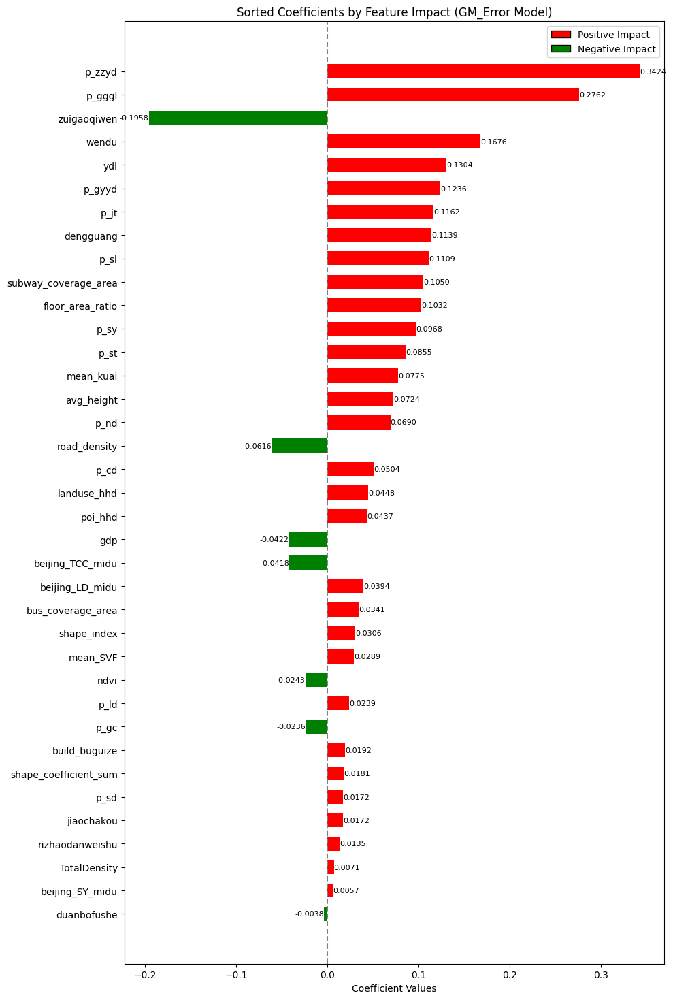

In [8]:
#正确的SEM基于空间误差模型（Spatial Error Model, SEM）广义矩估计
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from pysal.lib import weights
from pysal.model.spreg import GM_Error
import matplotlib.pyplot as plt

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 更新变量名列表以包含常数项
name_x_with_const = ['CONSTANT'] + X_columns

# 使用GM_Error进行回归，并提供变量名
sem_gmm = GM_Error(y=y, x=X_scaled_with_const, w=w, name_y=y_column, name_x=name_x_with_const)
print("GM_Error Results:\n", sem_gmm.summary)

# 提取GM_Error模型的系数
betas = sem_gmm.betas.flatten()

# 获取有效的变量名（去除可能被自动移除的常数项）
effective_variable_names = [name for name in name_x_with_const if name != 'CONSTANT']

# 构建DataFrame
coefficients_df = pd.DataFrame({
    'Variable': effective_variable_names,
    'Coefficient': betas[1:len(effective_variable_names)+1]  # 跳过 CONSTANT
})

# 过滤掉 CONSTANT 和 lambda (如果存在)
coefficients_df = coefficients_df[~coefficients_df['Variable'].isin(['lambda'])]

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=100)

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = 'red' if coef['Coefficient'] >= 0 else 'green'
    text_alignment = 'left' if coef['Coefficient'] >= 0 else 'right'
    text_x_offset = 0.0 if coef['Coefficient'] >= 0 else -0.0
    
    # 绘制条形图
    ax.barh(idx, coef['Coefficient'], color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef['Coefficient'] + text_x_offset, idx, f"{coef['Coefficient']:.4f}", 
            va='center', ha=text_alignment, fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact (GM_Error Model)')

# 图例
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='red', edgecolor='black', label='Positive Impact'),
                   Patch(facecolor='green', edgecolor='black', label='Negative Impact')]
ax.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [5]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from pysal.lib import weights
from pysal.model.spreg import GM_Error
import matplotlib.pyplot as plt
from matplotlib import cm

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_with_const = np.hstack((np.ones((X_scaled.shape[0], 1)), X_scaled))

# 创建空间权重矩阵，这里以K近邻为例
w = weights.KNN.from_array(np.array(coords), k=5)  # 使用np.array
w.transform = 'r'  # 转换为row-standardized形式

# 更新变量名列表以包含常数项
name_x_with_const = ['CONSTANT'] + X_columns

# 使用GM_Error进行回归，并提供变量名
sem_gmm = GM_Error(y=y, x=X_scaled_with_const, w=w, name_y=y_column, name_x=name_x_with_const)
print("GM_Error Results:\n", sem_gmm.summary)

# 提取GM_Error模型的系数
betas = sem_gmm.betas.flatten()

# 获取有效的变量名（去除可能被自动移除的常数项）
effective_variable_names = [name for name in name_x_with_const if name != 'CONSTANT']
if 'lambda' in sem_gmm.name_x:
    effective_variable_names += ['lambda']

# 构建DataFrame，但首先过滤掉 CONSTANT 和 lambda
coefficients_df = pd.DataFrame({
    'Variable': [var for var in effective_variable_names if var not in ['CONSTANT', 'lambda']],
    'Coefficient': betas[1:-1] if 'lambda' in sem_gmm.name_x else betas[1:]
})

# 定义名字映射
name_mapping = {
    'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
    'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
    'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
    'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
    'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
    'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
    'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
}

# 应用名字映射到Variable列
coefficients_df['Variable'] = coefficients_df['Variable'].apply(lambda x: name_mapping.get(x, x))

# 根据系数的绝对值进行排序
coefficients_sorted = coefficients_df.reindex(coefficients_df['Coefficient'].abs().sort_values(ascending=True).index)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(10, len(coefficients_sorted) * 0.4), dpi=1000)

# 获取指定位置颜色
positive_color = cm.viridis(0.9)
negative_color = cm.viridis(0.4)

# 数值标签与条形图的距离
text_x_offset = 0.00  # 可以根据实际需要调整此值

# 分别绘制正系数和负系数
for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
    color = positive_color if coef['Coefficient'] >= 0 else negative_color
    
    # 绘制条形图
    ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.6)
    
    # 添加数值标签，保留两位小数
    ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
            va='center', ha='left', fontsize=8)

# 调整y轴刻度和标签
ax.set_yticks(range(1, len(coefficients_sorted) + 1))
ax.set_yticklabels(coefficients_sorted['Variable'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values')
ax.set_title('Sorted Coefficients by Feature Impact (GM_Error Model)')

# 减少上下空白
plt.subplots_adjust(top=0.95, bottom=0.25)

plt.tight_layout()
plt.show()

GM_Error Results:
 REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: GM SPATIALLY WEIGHTED LEAST SQUARES
------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     value_x                Number of Observations:         937
Mean dependent var  :     38.8285                Number of Variables   :          38
S.D. dependent var  :      2.8771                Degrees of Freedom    :         899
Pseudo R-squared    :      0.5663

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        38.87572         0.10431       372.70426         0.00000
       build_buguize         0.01922         0.02541         0.75635         0.44944
          avg_height         0.07241         0.04

In [15]:
#gwr模型对比
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import warnings  # 导入warnings模块

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()
    
    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项
    
    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Feature': X_columns,
        'Coefficient': coef_means
    })
    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    
    # 注意：根据mgwr版本，可能需要调整这些属性名称
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误
    
    print("\nAverage Coefficients:")
    print(coefficients)
    
    
except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 235.0
Residual standard error: 1.3300
Multiple R-squared: 0.7861
Adjusted R-squared: 0.7658
AIC: 3357.5978
BIC: 3754.8197

Average Coefficients:
                  Feature  Coefficient
0           build_buguize     0.016392
1              avg_height     0.069763
2   shape_coefficient_sum    -0.175164
3              jiaochakou     0.022614
4               mean_kuai     0.271016
5             shape_index     0.402374
6            TotalDensity    -0.290733
7             duanbofushe    -0.097853
8         rizhaodanweishu     0.383664
9                   wendu     0.618653
10                    gdp     0.095655
11              dengguang     0.157264
12                   ndvi    -0.210965
13               mean_SVF    -0.085068
14            zuigaoqiwen    -0.557780
15                    ydl     0.531489
16        beijing_LD_midu     0.147305
17        beijing_SY_midu    -0.029784
18       beijing_TCC_midu    -0.165391
19                poi_hhd    -0.04490

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

# 假设coefficients DataFrame已经在之前的代码中定义并填充了数据

# 打印coefficients DataFrame的前几行，以确认其内容
print("Coefficients DataFrame:")
print(coefficients.head())

# 确认coefficients包含'Feature'和'Coefficient'两列
if 'Feature' not in coefficients.columns or 'Coefficient' not in coefficients.columns:
    raise ValueError("Coefficients DataFrame must contain 'Feature' and 'Coefficient' columns.")

# 计算绝对值并根据绝对值大小升序排列
coefficients['Abs_Coefficient'] = abs(coefficients['Coefficient'])
coefficients_sorted = coefficients.sort_values(by='Abs_Coefficient', ascending=True)

# 设置绘图参数
fig, ax = plt.subplots(figsize=(12, 10), dpi=1000)
font = {'family': 'Times New Roman'}
plt.rc('font', **font)

# 绘制条形图，并根据系数的正负决定文本标签的位置
for idx, (feature, coef) in enumerate(zip(coefficients_sorted.index, coefficients_sorted['Coefficient']), start=1):
    if coef >= 0:
        color = 'red'
        text_alignment = 'left'
        text_x_offset = 0.02
    else:
        color = 'green'
        text_alignment = 'right'
        text_x_offset = -0.02
    
    # 绘制条形图
    ax.barh(idx, coef, color=color, height=0.6)
    
    # 添加数值标签
    ax.text(coef + text_x_offset, idx, f"{coef:.4f}", va='center', ha=text_alignment, fontsize=8, fontdict=font)

# 设置y轴标签
ax.set_yticks(range(1, len(coefficients_sorted)+1))
ax.set_yticklabels(coefficients_sorted['Feature'])

# 添加分割线帮助区分正负影响
ax.axvline(x=0, color='grey', linestyle='--')

ax.set_xlabel('Coefficient Values', fontdict=font)
ax.set_title('GWR Coefficients by Feature (Positive vs Negative Impact)', fontdict=font)

# 图例
ax.legend(['Negative Impact', 'Positive Impact'], prop={'family': 'Times New Roman'})

plt.tight_layout()
plt.show()

Coefficients DataFrame:
                 Feature  Coefficient
0          build_buguize     0.016392
1             avg_height     0.069763
2  shape_coefficient_sum    -0.175164
3             jiaochakou     0.022614
4              mean_kuai     0.271016


In [10]:
import pandas as pd
from mgwr.gwr import GWR, Gaussian
from mgwr.sel_bw import Sel_BW
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import warnings  # 导入warnings模块

# 忽略所有警告
warnings.filterwarnings("ignore")

# 设置文件路径
file_path = r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv"

# 读取CSV文件
df = pd.read_csv(file_path)

# 假设数据中包含因变量'y'和自变量列表
y_column = 'value_x'
X_columns = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']

# 提取因变量和自变量（基于指定的特征）
y = df[y_column].values.reshape((-1, 1))
X = df[X_columns]

# 创建坐标点
coords = list(zip(df['X2'], df['Y']))

# 数据标准化
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 将标准化后的数据转换回DataFrame以保留列名
X_scaled_df = pd.DataFrame(X_scaled, columns=X_columns)

# 检查是否有缺失值并处理
if np.any(np.isnan(X_scaled_df)) or np.any(np.isnan(y)):
    print("Warning: There are NaN values in the data.")
    # 删除含有NaN值的行
    mask = ~np.isnan(y.flatten())
    y = y[mask]
    X_scaled_df = X_scaled_df[mask].reset_index(drop=True)  # 重置索引以确保连续性
    coords = [coord for i, coord in enumerate(coords) if mask[i]]

try:
    bw = Sel_BW(coords, y, X_scaled_df.values, multi=False).search()
    gwr_model = GWR(coords, y, X_scaled_df.values, bw, fixed=False, kernel='gaussian').fit()
    
    # 获取每个特征的平均回归系数
    coef_means = np.mean(gwr_model.params, axis=0)[1:]  # 忽略截距项
    
    # 分离正负系数并创建DataFrame
    coefficients = pd.DataFrame({
        'Variable': X_columns,
        'Coefficient': coef_means
    })
    # 应用名字映射到Variable列
    name_mapping = {
        'beijing_LD_midu': 'DGF', 'beijing_SY_midu': 'DCF', 'beijing_TCC_midu': 'PLD',
        'poi_hhd': 'MUOI', 'road_density': 'RD', 'bus_coverage_area': 'BCM',
        'subway_coverage_area': 'SSCM', 'floor_area_ratio': 'FAR', 'p_cd': 'GF',
        'p_gyyd': 'PGF', 'p_gggl': 'AF', 'p_gc': 'SF', 'p_jt': 'TSF', 'p_ld': 'BLF',
        'p_nd': 'CF', 'p_sl': 'FF', 'p_sy': 'CSF', 'p_sd': 'WF', 'p_st': 'WBF',
        'p_zzyd': 'RF', 'landuse_hhd': 'MULT', 'ndvi': 'NDVI', 'duanbofushe': 'ASWR',
        'rizhaodanweishu': 'AAS', 'wendu': 'AMT', 'build_buguize': 'BBI',
        'avg_height': 'MBH', 'shape_coefficient_sum': 'BSC', 'jiaochakou': 'NRD',
        'shape_index': 'MSI', 'TotalDensity': 'ED', 'mean_SVF': 'SVF', 'gdp': 'GDP',
        'zuigaoqiwen': 'AMMTmax', 'mean_kuai': 'PD', 'dengguang': 'NLD', 'ydl':'EC'
    }
    coefficients['Feature'] = coefficients['Variable'].apply(lambda x: name_mapping.get(x, x))
    coefficients = coefficients[['Feature', 'Coefficient']]
    
    # 输出结果摘要
    print("\n--- GWR Model Summary ---")
    print(f"Bandwidth: {bw}")
    print(f"Residual standard error: {np.std(gwr_model.resid_response):.4f}")
    print(f"Multiple R-squared: {gwr_model.R2:.4f}")
    print(f"Adjusted R-squared: {gwr_model.adj_R2:.4f}")
    print(f"AIC: {gwr_model.aic:.4f}")
    print(f"BIC: {gwr_model.bic:.4f}")  # 修正了这里的语法错误
    
    print("\nAverage Coefficients:")
    print(coefficients)
    
    # 根据系数的绝对值进行排序
    coefficients_sorted = coefficients.reindex(coefficients['Coefficient'].abs().sort_values(ascending=True).index)
    
    # 设置绘图参数
    fig, ax = plt.subplots(figsize=(8, len(coefficients_sorted) * 0.4), dpi=1000)
    font = {'family': 'Times New Roman'}
    plt.rc('font', **font)

    # 获取指定位置颜色
    positive_color = cm.viridis(0.9)
    negative_color = cm.viridis(0.4)

    # 数值标签与条形图的距离
    text_x_offset = 0.00  # 可以根据实际需要调整此值

    # 分别绘制正系数和负系数
    for idx, (feature, coef) in enumerate(coefficients_sorted.iterrows(), start=1):
        color = positive_color if coef['Coefficient'] >= 0 else negative_color
        
        # 绘制条形图
        ax.barh(idx, abs(coef['Coefficient']), color=color, height=0.85)
        
        # 添加数值标签，保留两位小数
        ax.text(abs(coef['Coefficient']) + text_x_offset, idx, f"{coef['Coefficient']:.2f}", 
                va='center', ha='left', fontsize=14, fontdict=font)

    # 调整y轴刻度和标签
    ax.set_yticks(range(1, len(coefficients_sorted) + 1))
    ax.set_yticklabels(coefficients_sorted['Feature'], fontsize=16)

    # 添加分割线帮助区分正负影响
    ax.axvline(x=0, color='grey', linestyle='--')
    font = {'size': 16}
    ax.set_xlabel('Coefficient Values', fontdict=font)
    ax.set_title('Sorted Coefficients by Feature Impact (GWR Model)', fontdict=font)

    # 减少上下空白
    plt.subplots_adjust(top=0.95, bottom=0.25)

    plt.tight_layout()
    plt.show()

except np.linalg.LinAlgError as e:
    print(f"Error in GWR: Matrix is singular. Consider reducing the number of features or using regularization.")


--- GWR Model Summary ---
Bandwidth: 227.0
Residual standard error: 1.3165
Multiple R-squared: 0.7904
Adjusted R-squared: 0.7700
AIC: 3342.2084
BIC: 3748.4069

Average Coefficients:
    Feature  Coefficient
0       BBI     0.016330
1       MBH     0.069888
2       BSC    -0.172952
3       NRD     0.020811
4        PD     0.266930
5       MSI     0.399370
6        ED    -0.293461
7      ASWR    -0.103499
8       AAS     0.385821
9       AMT     0.625023
10      GDP     0.100598
11      NLD     0.158735
12     NDVI    -0.207843
13      SVF    -0.086920
14  AMMTmax    -0.548932
15       EC     0.530732
16      DGF     0.145263
17      DCF    -0.031655
18      PLD    -0.163043
19     MUOI    -0.044614
20       GF    -0.084067
21      PGF     0.224306
22       AF     0.721014
23       SF    -0.206915
24      TSF     0.377552
25      BLF     0.070337
26       CF     0.139650
27       FF     0.237699
28      CSF     0.280197
29       WF     0.019971
30      WBF     0.303761
31       RF     0